# Convolutional Neural Network Filter Bank for Musical Instruments Classification
## Author: Renato de Castro Rabelo Profeta
### Date: October, 2020
#### Applied Media Systems Group, Ilmenau University of Technology, Germany

## Colab Runtime Configurations


In [1]:
# Install torchaudio
!pip install torchaudio -f https://download.pytorch.org/whl/torch_stable.html
#!pip install torch==1.7.0+cu101 torchvision==0.8.1+cu101 torchaudio==0.7.0 -f https://download.pytorch.org/whl/torch_stable.html


Looking in links: https://download.pytorch.org/whl/torch_stable.html
     |████████████████████████████████| 1.9MB 18.6MB/s 


## Imports and Configuration

In [2]:
# Imports

## Numerical Computing
import numpy as np
import itertools

## File System and Files Handling
import os
from zipfile import ZipFile

## Python Serialization
import pickle

## Audio Processing
import librosa.display, librosa
import torchaudio

## Plotting and Visualization
import matplotlib.pyplot as plt
import IPython.display as ipd
from IPython.core.display import HTML, display, Image

## Machine Learning ´
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
from sklearn.metrics import recall_score, precision_score, accuracy_score
from sklearn.metrics import confusion_matrix, f1_score, classification_report
from sklearn.metrics import mean_squared_error

## Deep Learning
import torch
from torch.utils.data import Dataset, DataLoader
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.tensorboard import SummaryWriter

In [3]:
# Seeds for reproducibility
torch.manual_seed(0)
np.random.seed(0)

In [4]:
# Configurations
## Create Directory for Checkpoints
!mkdir -p checkpoints

## Check CPU or GPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


In [5]:
# Configure Tensorboard
%load_ext tensorboard

In [6]:
logs_base_dir = "runs"
os.makedirs(logs_base_dir, exist_ok=True)

## Download the dataset from Dropbox

In [7]:
# Download the dataset from Dropbox
!wget -O dataset.zip https://www.dropbox.com/s/su4rvaipccm1lit/all-samples_npy_pkl.zip?dl=0

--2021-05-09 20:38:31--  https://www.dropbox.com/s/su4rvaipccm1lit/all-samples_npy_pkl.zip?dl=0
Resolving www.dropbox.com (www.dropbox.com)... 162.125.6.18, 2620:100:601c:18::a27d:612
Connecting to www.dropbox.com (www.dropbox.com)|162.125.6.18|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: /s/raw/su4rvaipccm1lit/all-samples_npy_pkl.zip [following]
--2021-05-09 20:38:31--  https://www.dropbox.com/s/raw/su4rvaipccm1lit/all-samples_npy_pkl.zip
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://uceb3d1137410d2ce1e48e505856.dl.dropboxusercontent.com/cd/0/inline/BOLSyClAuAD4wxiLZKkyaBX_r5VhfF2flHyHGd52SJBfy3GVT5-lOYbRhMIcZNij3C89Jfm5crdVB8wC5yHvzDY-Qm5xes4iST1Dnyrk30RYVVk-EsOELRzZBiD333TJdqjoUAP7N0IgwNTJa3fkL_2K/file# [following]
--2021-05-09 20:38:32--  https://uceb3d1137410d2ce1e48e505856.dl.dropboxusercontent.com/cd/0/inline/BOLSyClAuAD4wxiLZKkyaBX_r5VhfF2flHyHGd52SJBfy3GVT5-l

## Extract .zip 

In [8]:
with ZipFile('dataset.zip', 'r') as zipObj:
   # Extract all the contents of zip file in current directory
   zipObj.extractall()


## Get Dataset Metadata from GitHub

In [9]:
# Clone github in Google Colab
!git clone https://github.com/param1707/-Optimizing-a-neural-network-filter-bank-for-musical-instrument-classification-.git 

Cloning into '-Optimizing-a-neural-network-filter-bank-for-musical-instrument-classification-'...
remote: Enumerating objects: 1956, done.
remote: Counting objects: 100% (776/776), done.
remote: Compressing objects: 100% (316/316), done.
remote: Total 1956 (delta 468), reused 764 (delta 460), pack-reused 1180
Receiving objects: 100% (1956/1956), 1.18 GiB | 47.27 MiB/s, done.
Resolving deltas: 100% (1120/1120), done.
Checking out files: 100% (305/305), done.


In [10]:
# Load Train Set
with open('./-Optimizing-a-neural-network-filter-bank-for-musical-instrument-classification-/datasetMetadata/train_set_dataframe.pkl', 'rb') as f:
  train_set = pickle.load(f)
#Load Test Set
with open('./-Optimizing-a-neural-network-filter-bank-for-musical-instrument-classification-/datasetMetadata/test_set_dataframe.pkl', 'rb') as f:
  test_set = pickle.load(f)

## Encode Labels

In [11]:
# Encode Labels Train Set
labelencoder = LabelEncoder()
labelencoder.fit(train_set['class'].values.tolist())
print(len(labelencoder.classes_), "classes:", ", ".join(list(labelencoder.classes_)))
classes_int_train = labelencoder.transform(train_set['class'].values.tolist())

#OneHotEncoding
encoder=OneHotEncoder(sparse=False, categories="auto")
onehot_labels_train=encoder.fit_transform(classes_int_train.reshape(len(classes_int_train),1))

20 classes: banjo, bass-clarinet, bassoon, cello, clarinet, contrabassoon, double-bass, english-horn, flute, french-horn, guitar, mandolin, oboe, percussion, saxophone, trombone, trumpet, tuba, viola, violin


In [12]:
# Encode Labels Test Set
labelencoder.fit(test_set['class'].values.tolist())
print(len(labelencoder.classes_), "classes:", ", ".join(list(labelencoder.classes_)))
classes_int_test = labelencoder.transform(test_set['class'].values.tolist())

#OneHotEncoding
encoder=OneHotEncoder(sparse=False, categories="auto")
onehot_labels_test=encoder.fit_transform(classes_int_test.reshape(len(classes_int_test),1))

20 classes: banjo, bass-clarinet, bassoon, cello, clarinet, contrabassoon, double-bass, english-horn, flute, french-horn, guitar, mandolin, oboe, percussion, saxophone, trombone, trumpet, tuba, viola, violin


## Create PyTorch Datasets for Training and Testing

In [15]:
# Dataset Class
class dataset(Dataset):
    """An abstract class representing a Dataset.

    Author: Renato de Castro Rabelo Profeta, October 2020, TU Ilmenau Germany
    """
    def __init__(self, files, labels):
        self.labels = labels
        self.files = files

    def __len__(self):
        return len(self.files)

    def __getitem__(self, index):
      x_numpy = np.load(self.files[index])
      X = torch.from_numpy(x_numpy)
      X /= torch.abs(X).max()  # Normalize
      X = torch.reshape(X,(1,-1)) # Reshape for Model
      y_labels = torch.tensor(self.labels[index]) #Labels Out
      return X,y_labels

In [16]:
# Create Sets
train_set_torch = dataset(train_set['filename'].values.tolist(), onehot_labels_train)
test_set_torch = dataset(test_set['filename'].values.tolist(), onehot_labels_test)

In [17]:
# Data Loader.
training_generator = DataLoader(train_set_torch, batch_size=1, shuffle=False, num_workers=0)
validation_generator = DataLoader(test_set_torch, batch_size=1, shuffle=False, num_workers=0)

### Testing Dataset and Dataloader

In [116]:
# Get a random audio file and label from dataset
dataiter = iter(DataLoader(train_set_torch, batch_size=1, shuffle=True, num_workers=0))
audio_to_test, label_to_test = dataiter.next()

In [117]:
# Calculate Spectrogram of the audio file to test
specgram = torchaudio.transforms.Spectrogram(n_fft=2048)(audio_to_test[0,0,:])


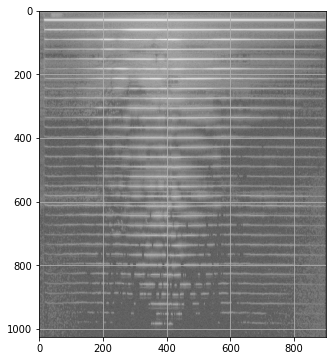

In [118]:
# Plot Spectrogram of audio to test
plt.figure(figsize=(10,6))
plt.imshow(20*specgram.log10().numpy(), cmap='gray')
plt.grid()

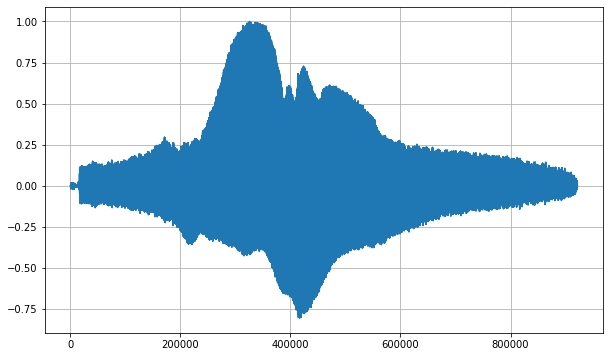

In [119]:
# Plot Waveform of audio to test
plt.figure(figsize=(10,6))
plt.plot(audio_to_test[0,0,:])
plt.grid()

In [120]:
# Listen to audio
ipd.Audio(audio_to_test[0,0,:], rate=44100) # load a local WAV file

## PyTorch Analysis Filter Bank / Encoder Model

In [122]:
# Model Parameters
in_channels = 1
n_subbands = 512
filter_length = 1024
downsampling = 512
padding = filter_length//2
#Encoder( (conv1): Conv1d(1, 512, kernel_size=(1024,), stride=(512,), padding=(512,), bias=False) )

In [123]:
# Analysis Filter Bank / Encoder
class Encoder(torch.nn.Module):
  """ Convolutional Neural Network Analysis Filter Bank for Musical Instruments Classification

  Author: Renato de Castro Rabelo Profeta, October 2020, TU Ilmenau, Germany
  """
  def __init__(self, in_channels=1,n_subbands=512,filter_length=1024,downsampling=512, padding=512, bias=False):
    super(Encoder, self).__init__()
    # Parameters
    self.in_channels = in_channels
    self.n_subbands = n_subbands
    self.filter_length=filter_length
    self.downsampling=downsampling
    self.padding = padding
    self.bias = bias
    # Layers
    self.conv1 = torch.nn.Conv1d(in_channels=self.in_channels, out_channels=self.n_subbands, kernel_size=self.filter_length, 
                                 stride=self.downsampling, padding=self.padding, bias=self.bias)

  def forward(self, x):
    x = self.conv1(x)
    return x

### Weights Initialization

In [124]:
# Weights Initialization Function
def weights_init(m):
    if isinstance(m, nn.Conv1d):
        torch.nn.init.xavier_uniform_(m.weight.data)
        #torch.nn.init.zeros_(m.bias.data)
    if isinstance(m, nn.ConvTranspose1d):
        torch.nn.init.xavier_uniform_(m.weight.data)
        #torch.nn.init.zeros_(m.bias.data)
    if isinstance(m, nn.Conv2d):
        torch.nn.init.xavier_uniform_(m.weight.data)
        torch.nn.init.zeros_(m.bias.data)
    if isinstance(m, nn.Linear):
        torch.nn.init.xavier_uniform_(m.weight.data)
        torch.nn.init.zeros_(m.bias.data)

### Testing Encoder before Training

In [125]:
# Create Analysis Filter Bank model
analysisFB = Encoder(in_channels=in_channels,n_subbands=n_subbands,filter_length=filter_length,downsampling = downsampling, padding=padding)
# Initialize weights
analysisFB.apply(weights_init)
# Send to Device
analysisFB.to(device)
#Encoder( (conv1): Conv1d(1, 512, kernel_size=(1024,), stride=(512,), padding=(512,), bias=False) )

Encoder(
  (conv1): Conv1d(1, 512, kernel_size=(1024,), stride=(512,), padding=(512,), bias=False)
)

In [126]:
test_encoder = analysisFB(audio_to_test.to(device))
print('Input Shape', audio_to_test.shape)
print('Output Shape', test_encoder.shape)

Input Shape torch.Size([1, 1, 921600])
Output Shape torch.Size([1, 512, 1801])


In [127]:
# Display Number of Trainable Parameters
pytorch_total_params = sum(p.numel() for p in analysisFB.parameters() if p.requires_grad)
print("Number of Trainable Parameters:",pytorch_total_params)

Number of Trainable Parameters: 524288


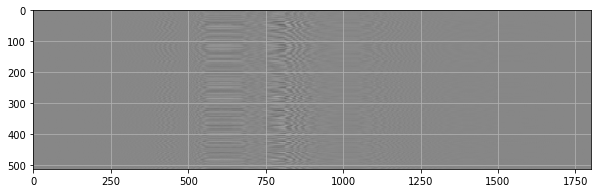

In [128]:
# Plot of encoded audio to test
plt.figure(figsize=(10,6))
plt.imshow(test_encoder[0,:,:].detach().cpu().numpy(), cmap='gray')
plt.grid()

## PyTorch CNN Classification Model

In [129]:
# Model Parameters
n_classes=20

In [130]:
class classificationModel(torch.nn.Module):
  """ CNN CLassifier for an Analysis Filter Bank for Musical Instruments Classification
  
  Author: Renato de Castro Rabelo Profeta, October 2020, TU Ilmenau, Germany
  """
  def __init__(self, n_classes=20):
    super(classificationModel, self).__init__()
    self.n_classes=n_classes
    
    self.conv1 = torch.nn.Conv2d(1, 1, kernel_size=3, stride=1, padding=1)
    self.pool1 = torch.nn.MaxPool2d(2)
    self.dropout1 = torch.nn.Dropout(p=0.4)
    self.conv2 = torch.nn.Conv2d(1, 1, kernel_size=3, stride=1, padding=1)
    self.dropout2 = torch.nn.Dropout(p=0.4)
    self.adpavpool = torch.nn.AdaptiveAvgPool2d((8,8))
    self.fc1 = torch.nn.Linear(8*8, 32)
    self.fc2 = torch.nn.Linear(32, self.n_classes)
    
  def forward(self, x):
    x = x.unsqueeze(0)
    x = self.conv1(x)
    x = self.pool1(x)
    x = self.dropout1(x)
    x = self.conv2(x)
    x = self.dropout2(x)
    x = self.adpavpool(x)
    x = x.view(x.size()[0], -1)
    x = torch.sigmoid(self.fc1(x))
    x = F.softmax(self.fc2(x), dim=-1)
    return x

### Test Classification Model before Training

In [131]:
# Create Classification Model
classify = classificationModel()
# Initialize weights
classify.apply(weights_init)
# Send to Device
classify.to(device)

classificationModel(
  (conv1): Conv2d(1, 1, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (pool1): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (dropout1): Dropout(p=0.4, inplace=False)
  (conv2): Conv2d(1, 1, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (dropout2): Dropout(p=0.4, inplace=False)
  (adpavpool): AdaptiveAvgPool2d(output_size=(8, 8))
  (fc1): Linear(in_features=64, out_features=32, bias=True)
  (fc2): Linear(in_features=32, out_features=20, bias=True)
)

In [132]:
# Display Number of Trainable Parameters
pytorch_total_params = sum(p.numel() for p in classify.parameters() if p.requires_grad)
print("Number of Trainable Parameters:",pytorch_total_params)

Number of Trainable Parameters: 2760


In [133]:
# Test
test_classify = classify(test_encoder)
print("Predicted Class:", np.argmax(test_classify.detach().cpu().numpy()))
print('Correct Class:', np.argmax(label_to_test.detach().cpu().numpy()))
print("Output of Classifier Shape:", test_classify.shape)

Predicted Class: 2
Correct Class: 7
Output of Classifier Shape: torch.Size([1, 20])


## PyTorch CNN Autoencoder Model with Classification

In [134]:
# Audoencoder
class Autoencoder(nn.Module):
  """ CNN Autoencoder with an Embedded CLassifier for Musical Instruments Classification
  
  Author: Renato de Castro Rabelo Profeta, October 2020, TU Ilmenau, Germany
  """
  
  def __init__(self, encoder, classifier):
    super(Autoencoder, self).__init__()
    self.encoder = encoder
    self.classifier = classifier
    #self.decoder = decoder
    
  def forward(self, x):
    encoded = self.encoder(x)
    classified = self.classifier(encoded)
    #decoded = self.decoder(encoded)
    #return encoded, decoded, classified
    return encoded, classified

### Testing Autoencoder before Training

In [138]:
# Create Autoencoder Model
autoencoder = Autoencoder(analysisFB,classify)
# Send to Device
autoencoder.to(device)

Autoencoder(
  (encoder): Encoder(
    (conv1): Conv1d(1, 512, kernel_size=(1024,), stride=(512,), padding=(512,), bias=False)
  )
  (classifier): classificationModel(
    (conv1): Conv2d(1, 1, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (pool1): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (dropout1): Dropout(p=0.4, inplace=False)
    (conv2): Conv2d(1, 1, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (dropout2): Dropout(p=0.4, inplace=False)
    (adpavpool): AdaptiveAvgPool2d(output_size=(8, 8))
    (fc1): Linear(in_features=64, out_features=32, bias=True)
    (fc2): Linear(in_features=32, out_features=20, bias=True)
  )
)

In [140]:
# Test
test_encoded, test_type = autoencoder(audio_to_test.to(device))
print('Encoded Shape', test_encoded.shape)
print('Decoded Shape', test_output.shape)
print('Predicted Class', np.argmax(test_type.detach().cpu().numpy()))

Encoded Shape torch.Size([1, 512, 1801])
Decoded Shape torch.Size([1, 20])
Predicted Class 2


## Define a Loss Function

In [141]:
class categorical_cross_entropy(nn.Module):
    ''' Categorical Cross Entropy similar to Keras/TensorFlow
        "Categorical crossentropy between an output tensor and a target tensor" - https://www.tensorflow.org/api_docs/python/tf/keras/backend/categorical_crossentropy
        https://github.com/tensorflow/tensorflow/blob/r1.13/tensorflow/python/keras/backend.py
        target: A tensor of the same shape as `inputX`.
        inputX: A tensor resulting from a softmax

        Ported to PyTorch by Renato Profeta, October 2020
    '''
    def __init__(self):
        super(categorical_cross_entropy, self).__init__()

    def forward(self, inputX, target):
        eps=1e-10
        tmp = inputX.clone()
        tmp /= torch.sum(tmp)
        torch.clamp_(tmp, min=eps, max = 1-eps)
        return torch.mean(-torch.sum(target * torch.log(tmp.double()), dim=-1), dim=-1)

## Set a Loss Function and an Optimizer for the Experiment

In [142]:
# Loss Functions
loss_classification = categorical_cross_entropy()
loss_decoder = torch.nn.MSELoss()

# Optimizer
lr=0.01
#optimizer = optim.SGD(autoencoder.parameters(), lr=lr)
optimizer = optim.Adagrad(autoencoder.parameters(), lr=0.01, lr_decay=0, weight_decay=0, initial_accumulator_value=0, eps=1e-10)
#optimizer = optim.ASGD(autoencoder.parameters(), lr=lr)

## Auxiliary Functions for Progress Monitoring

In [143]:
# https://colab.research.google.com/drive/11v_mM2ImWdKDs_4qkoB9TdsQiPgVeeo2#scrollTo=NQgIwI5WC-07        
class ProgressMonitor(object):
    """
    Custom IPython progress bar
    """
    
    tmpl_train ="""
        <p> Train Epoch: {epoch} / {num_epochs} <br>
        Step: {value} / {length} - Train <br>
        Loss Classification: {loss_classify:0.4f} / Accuracy Classification: {accuracy_classify:0.4f} <br> 
        Total Loss: {loss_total:0.4f}</p>
        <progress value='{value}' max='{length}', style='width: 100%'>{value}</progress>
        <br>"""
    
    tmpl_test= """
        <p>Test Epoch: {epoch} / {num_epochs} <br>
        Step: {value} / {length} - Test <br>
        Loss Classification: {loss_classify:0.4f} / Accuracy Classification: {accuracy_classify:0.4f} <br> 
        Total Loss: {loss_total:0.4f}</p> </p>
        <progress value='{value}' max='{length}', style='width: 100%'>{value}</progress>
        <br>"""

    def __init__(self, length, mode):
        self.length = length
        self.count = 0
        self.mode = mode
        self.display = display(self.html(0, 0, 0, 0, 0, 0, mode), display_id=True)   
        
    def html(self, count, epoch, num_epochs, loss_classify, accuracy_classify, loss_total,mode="train"):
        if mode=="train":
            return HTML(self.tmpl_train.format(length=self.length, value=count, epoch=epoch, num_epochs=num_epochs, 
                                               loss_classify=loss_classify, accuracy_classify=accuracy_classify,
                                               loss_total=loss_total))
        else:
            return HTML(self.tmpl_test.format(length=self.length, value=count, epoch=epoch, num_epochs=num_epochs, 
                                               loss_classify=loss_classify, accuracy_classify=accuracy_classify,
                                               loss_total=loss_total))
            
    def update(self, count, epoch, num_epochs, loss_classify, accuracy_classify,loss_total,mode="train"):
        self.count += count
        self.display.update(self.html(self.count, epoch, num_epochs, loss_classify, accuracy_classify, loss_total, mode))

In [144]:
# https://colab.research.google.com/drive/1gJAAN3UI9005ecVmxPun5ZLCGu4YBtLo#scrollTo=ZvoPaJvs7Eem
class AverageBase(object):
    
    def __init__(self, value=0):
        self.value = float(value) if value is not None else None
       
    def __str__(self):
        return str(round(self.value, 4))
    
    def __repr__(self):
        return self.value
    
    def __format__(self, fmt):
        return self.value.__format__(fmt)
    
    def __float__(self):
        return self.value
    

class RunningAverage(AverageBase):
    """
    Keeps track of a cumulative moving average (CMA).
    """
    
    def __init__(self, value=0, count=0):
        super(RunningAverage, self).__init__(value)
        self.count = count
        
    def update(self, value):
        self.value = (self.value * self.count + float(value))
        self.count += 1
        self.value /= self.count
        return self.value

class MovingAverage(AverageBase):
    """
    An exponentially decaying moving average (EMA).
    """
    
    def __init__(self, alpha=0.99):
        super(MovingAverage, self).__init__(None)
        self.alpha = alpha
        
    def update(self, value):
        if self.value is None:
            self.value = float(value)
        else:
            self.value = self.alpha * self.value + (1 - self.alpha) * float(value)
        return self.value

## Auxiliary Functions to save Model Parameters

In [145]:

# Save a Model
def save_checkpoint(optimizer, loss_classification, model, epoch, filename):
    global bestm
    checkpoint_dict = {
        'optimizer': optimizer.state_dict(),
        'model': model.state_dict(),
        'epoch': epoch,
        'loss_classification': loss_classification.state_dict(),
        #'loss_decoder': loss_decoder.state_dict()
    }

    torch.save(checkpoint_dict, filename)

# Load a Model
def load_checkpoint(optimizer, loss_classification, model, filename):
    checkpoint_dict = torch.load(filename)
    epoch = checkpoint_dict['epoch']
    model.load_state_dict(checkpoint_dict['model'])
    loss_classification.load_state_dict(checkpoint_dict['loss_classification'])
    #loss_decoder.load_state_dict(checkpoint_dict['loss_decoder'])
    if optimizer is not None:
        optimizer.load_state_dict(checkpoint_dict['optimizer'])
    return epoch

## Function to Train a Model

In [146]:
# Training Function
def trainModel(model, epoch, num_epochs, monitoring=True):
  """ Function to Train a Model

  Author: Renato de Castro Rabelo Profeta, October 2020, TU Ilmenau, Germany
  """
  if monitoring:
    progress = ProgressMonitor(length=len(train_set), mode="train")
  
  # Initialize Metrics
  train_loss_classify = MovingAverage()
  #train_loss_decoder = MovingAverage()
  train_loss_total = MovingAverage()
  train_acc = MovingAverage()
    
  # Train Stage
  model.train()
    
  # keep track of X predictions amd metrics
  x_pred = []

  for i, (batch, targets) in enumerate(training_generator):
    # Move the training data to the GPU
    batch = batch.to(device)
    targets = targets.to(device)

    # clear previous gradient computation
    optimizer.zero_grad()

    # forward propagation
    classified = model(batch)

    
    #target=target.to(device)
    # calculate the loss
    loss1 = loss_classification(classified, targets)
    #loss2 = loss_decoder(decoded, target)

    loss = w_class*loss1
    # backpropagate to compute gradients
    loss.backward()

    # update model weights
    optimizer.step()

    # update average loss
    train_loss_classify.update(loss1)
    #train_loss_decoder.update(loss2)
    train_loss_total.update(loss)
            
    # save X predictions
    x_pred.extend(classified.argmax(dim=-1).cpu().numpy())
        
    # calculate accuracy
    x_pred_torch = torch.tensor(x_pred, dtype=torch.int64)
    accuracy = torch.mean((x_pred_torch == torch.tensor(np.argmax(onehot_labels_train[:len(x_pred)],axis=1), dtype=torch.int64)).float())
        
    # update average accuracy
    train_acc.update(accuracy)
            
    # Update Progress Bar
    if monitoring:
      progress.update(batch.shape[0], epoch, num_epochs, train_loss_classify, train_acc,train_loss_total, mode="train")
  # Save a checkpoint
  checkpoint_filename = 'checkpoints/AutoencoderInstrumetClassif-{:03d}.pkl'.format(epoch)
  save_checkpoint(optimizer, loss_classification, model, epoch, checkpoint_filename)
  return train_loss_classify.value, train_acc.value , train_loss_total.value, x_pred

## Funtion to Test a Model

In [147]:
def testModel(model, epoch, num_epochs, monitoring=True):
  """ Function to Test a Model

  Author: Renato de Castro Rabelo Profeta, October 2020, TU Ilmenau, Germany
  """
  if monitoring:
    #Create a Progress Bar
    progress = ProgressMonitor(length=len(test_set), mode="test")
    
    
  # validation phase
  model.eval()
    
  # Initialize Metrics
  test_loss_classify = MovingAverage()
  #test_loss_decoder = MovingAverage()
  test_loss_total = MovingAverage()
  test_acc = MovingAverage()

  # keep track of predictions
  y_pred = []
    
  with torch.no_grad():
    for batch, targets in validation_generator:
      
      # Move the training batch to the GPU
      batch = batch.to(device)
      targets = targets.to(device)

      # forward propagation
      classified = model(batch)

     

      # calculate the loss
      loss1 = loss_classification(classified, targets)
      #loss2 = loss_decoder(decoded, target)

      loss = w_class*loss1

      # update average loss
      test_loss_classify.update(loss1)
      #test_loss_decoder.update(loss2)
      test_loss_total.update(loss)

      # save predictions
      y_pred.extend(classified.argmax(dim=1).cpu().numpy())

      # Validation Accuracy
      y_pred_torch = torch.tensor(y_pred, dtype=torch.int64)
      accuracy = torch.mean((y_pred_torch == torch.tensor(np.argmax(onehot_labels_test[:len(y_pred)],axis=1), dtype=torch.int64)).float())
      test_acc.update(accuracy)

      # Update Progress Bar
      if monitoring:
        progress.update(batch.shape[0], epoch, num_epochs, test_loss_classify, test_acc, test_loss_total, mode="test")

        
    return test_loss_classify.value,  test_loss_total.value, test_acc.value, y_pred

## Experiment Parameters

In [148]:
# Training Parameters

n_epochs = 100

# Weights for Loss Functions
w_class = 1
w_decoder=100

In [149]:
writer = SummaryWriter()
writer.add_graph(autoencoder,audio_to_test.to(device) )
writer.flush()

In [150]:
%tensorboard --logdir {logs_base_dir}

Reusing TensorBoard on port 6006 (pid 387), started 0:36:49 ago. (Use '!kill 387' to kill it.)

<IPython.core.display.Javascript object>

In [152]:
def experiment(model, num_epochs = n_epochs, first_epoch = 1, monitoring=True, test_monitor=True):
  """ Function to Test a Model

  Author: Renato de Castro Rabelo Profeta, October 2020, TU Ilmenau, Germany
  """
  
  #Initialze Metrics
  train_losses = []
  train_accuracies = []
  #train_losses_decoder = []
  train_losses_total = []
  valid_losses = []
  valid_accuracies = []
  #valid_losses_decoder = []
  valid_losses_total=[]
  valid_predictions = []
  
  for epoch in range(first_epoch, num_epochs+1):
    #Train Model
    train_loss, train_acc, train_loss_total, x_pred =trainModel(model, epoch, num_epochs, monitoring)
    #Save Test Losses and Accuracies
    train_losses.append(train_loss)
    #train_losses_decoder.append(train_loss_decoder)
    train_losses_total.append(train_loss_total)
    train_accuracies.append(train_acc)

    if test_monitor:
      #Test Model
      valid_loss,  test_loss_total, valid_acc, y_pred = testModel(model, epoch, num_epochs, monitoring)
    else:
      valid_loss=0
      #test_loss_decoder=0
      test_loss_total=0
      valid_acc = 0
      y_pred = 0
      
    #Save Test Losses and Accuracies
    valid_losses.append(valid_loss)
    #valid_losses_decoder.append(test_loss_decoder)
    valid_losses_total.append(test_loss_total)
    valid_accuracies.append(valid_acc)
    valid_predictions.append(y_pred)


    writer.add_scalars('Losses', {'Train Classification Loss':train_loss,
                                    'Test Classification Loss':valid_loss,
                                    'Train Total Loss':train_loss_total,
                                    'Test Total Loss': test_loss_total}, epoch)
    
    writer.add_scalars('Classification Accuracy', {'Train Classification ':train_acc,
                                    'Test Classification':valid_acc}, epoch)

    writer.flush()

  writer.close()              
  return {"train_loss": train_losses, "train_loss_total": train_losses_total, "train_accuracies": train_accuracies,
            "valid_loss": valid_losses, "valid_loss_total": valid_losses_total, "valid_accuracies": valid_accuracies,
            "valid_predictions":  valid_predictions}

## Run an Experiment

In [153]:
# Run Experiment
hist = experiment(autoencoder, num_epochs=n_epochs, monitoring=True, test_monitor=True)

AttributeError: ignored

# **The saved checkpoint (model parameters) of the model with the smallest total loss.**

In [ ]:
smallest_train_loss_epoch = hist['train_loss_total'].index(min(hist['train_loss_total'])) + 1
print('smallest_train_loss_epoch:',smallest_train_loss_epoch)

smallest_train_loss_epoch: 118


In [ ]:
smallest_test_loss_epoch = hist['valid_loss_total'].index(min(hist['valid_loss_total'])) + 1
print('smallest_test_loss_epoch:',smallest_test_loss_epoch)

smallest_test_loss_epoch: 119


## Resume an Experiment from a saved Checkpoint

In [ ]:
!unzip /content/-Optimizing-a-neural-network-filter-bank-for-musical-instrument-classification-/Experiment3/last_checkpoints_600.zip -d checkpoints

Archive:  /content/-Optimizing-a-neural-network-filter-bank-for-musical-instrument-classification-/Experiment3/last_checkpoints_600.zip
  inflating: checkpoints/content/checkpoints/AutoencoderInstrumetClassif-600.pkl  


In [ ]:
n_epochs=700
epoch = load_checkpoint(optimizer, loss_classification, loss_decoder, autoencoder, 'checkpoints/content/checkpoints/AutoencoderInstrumetClassif-600.pkl')
print('Resuming training from epoch', epoch)
hist = experiment(autoencoder, num_epochs=n_epochs, first_epoch=epoch+1, test_monitor=True, monitoring=True)

Resuming training from epoch 600


# **saved checkpoint (model parameters) of the model with the smallest test loss**

In [ ]:
#print(epoch)
smallest_test_loss_epoch = hist['valid_loss_total'].index(min(hist['valid_loss_total'])) + 1
#print('smallest_test_loss_epoch:',smallest_test_loss_epoch)
smallest_test_loss_epoch = smallest_test_loss_epoch + epoch
print('smallest_test_loss_epoch:',smallest_test_loss_epoch)

smallest_test_loss_epoch: 694


## Experiment Results

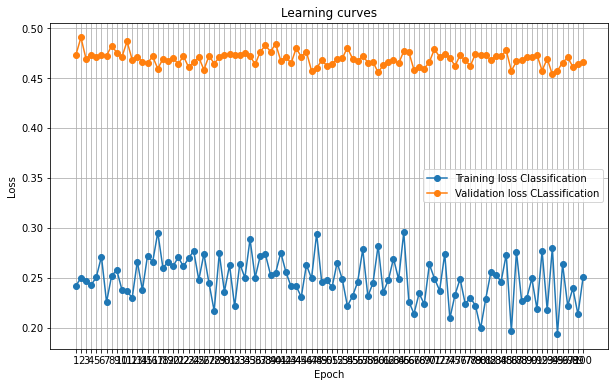

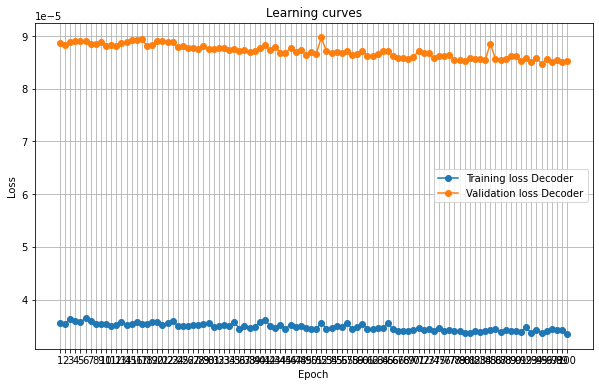

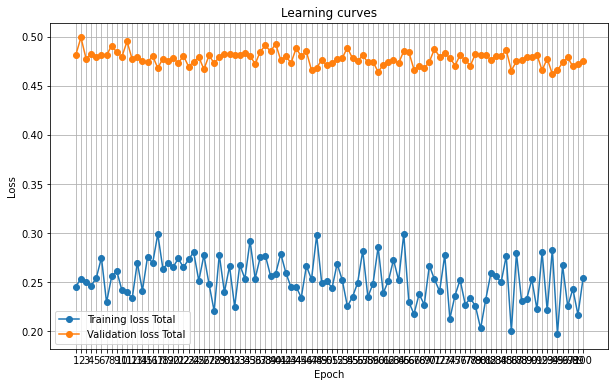

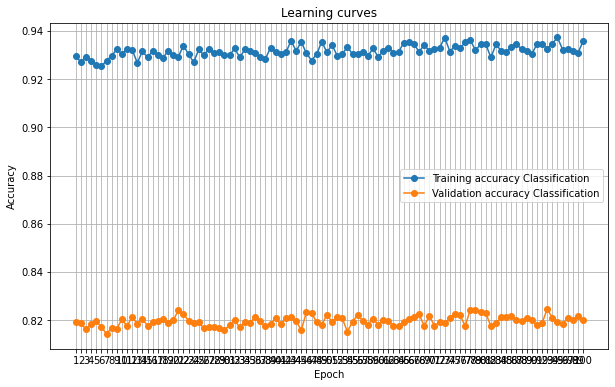

In [ ]:
epochs = range(1, len(hist["train_loss"]) + 1)

plt.figure(figsize=(10,6))
plt.plot(epochs, hist["train_loss"], '-o', label='Training loss Classification')
plt.plot(epochs, hist["valid_loss"], '-o', label='Validation loss CLassification')
plt.legend()
plt.title('Learning curves')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.xticks(epochs)
plt.grid()


plt.figure(figsize=(10,6))
plt.plot(epochs, hist["train_loss_decoder"], '-o', label='Training loss Decoder')
plt.plot(epochs, hist["valid_loss_decoder"], '-o', label='Validation loss Decoder')
plt.legend()
plt.title('Learning curves')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.xticks(epochs)
plt.grid()

plt.figure(figsize=(10,6))
plt.plot(epochs, hist["train_loss_total"], '-o', label='Training loss Total')
plt.plot(epochs, hist["valid_loss_total"], '-o', label='Validation loss Total')
plt.legend()
plt.title('Learning curves')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.xticks(epochs)
plt.grid()


plt.figure(figsize=(10,6))
plt.plot(epochs, hist["train_accuracies"], '-o', label='Training accuracy Classification')
plt.plot(epochs, hist["valid_accuracies"], '-o', label='Validation accuracy Classification')
plt.legend()
plt.title('Learning curves')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.xticks(epochs)
plt.grid()

In [ ]:
# Number of Validation Classification Errors
num_errors = torch.sum((torch.tensor(hist["valid_predictions"]) != torch.tensor(np.argmax(onehot_labels_test,axis=1))).float())
print('Validation errors {} (out of {})'.format(int(num_errors), len(test_set)))

In [ ]:
# Validation Classification Mistakes
error_indicator = torch.tensor(hist["valid_predictions"]) != torch.tensor(np.argmax(onehot_labels_test,axis=1))
print("Wrongly predicted Audio Files", test_set['filename'].values[np.where(error_indicator[0,:])])
print("Correct Classes:", test_set['class'].values[np.where(error_indicator[0,:])])
print("Predicted as:",labelencoder.inverse_transform(np.ravel(np.array(hist["valid_predictions"])[np.where(error_indicator)])))

Wrongly predicted Audio Files ['./all-samples/cello/cello_Fs5_05_pianissimo_arco-normal.npy'
 './all-samples/violin/violin_Cs4_1_mezzo-piano_con-sord.npy'
 './all-samples/bassoon/bassoon_E4_1_forte_normal.npy'
 './all-samples/violin/violin_F5_05_forte_arco-normal.npy'
 './all-samples/double-bass/double-bass_F3_05_fortissimo_arco-normal.npy'
 './all-samples/oboe/oboe_G6_025_piano_normal.npy'
 './all-samples/viola/viola_Ds5_1_mezzo-forte_molto-vibrato.npy'
 './all-samples/trombone/trombone_B4_long_fortissimo_normal.npy'
 './all-samples/trumpet/trumpet_Cs6_1_mezzo-forte_normal.npy'
 './all-samples/violin/violin_A6_1_piano_natural-harmonic.npy'
 './all-samples/trumpet/trumpet_G5_long_pianissimo_normal.npy'
 './all-samples/oboe/oboe_B3_025_mezzo-forte_normal.npy'
 './all-samples/tuba/tuba_G2_1_pianissimo_normal.npy'
 './all-samples/trombone/trombone_G4_very-long_piano_normal.npy'
 './all-samples/cello/cello_Cs2_1_mezzo-piano_arco-normal.npy'
 './all-samples/violin/violin_A4_phrase_forte_arc

In [ ]:
# Back to Labels
predictions_labels=labelencoder.inverse_transform(np.ravel(hist["valid_predictions"]));

In [ ]:
# Recall - the ability of the classifier to find all the positive samples
print("Recall: ", recall_score(classes_int_test, np.array(hist["valid_predictions"])[0,:],average=None))

# Precision - The precision is intuitively the ability of the classifier not to 
#label as positive a sample that is negative
print("Precision: ", precision_score(classes_int_test, np.array(hist["valid_predictions"])[0,:],average=None, zero_division=0))

# F1-Score - The F1 score can be interpreted as a weighted average of the precision 
#and recall
print("F1-Score: ", f1_score(classes_int_test, np.array(hist["valid_predictions"])[0,:], average=None))

# Accuracy - the number of correctly classified samples
print("Accuracy: %.2f  ," % accuracy_score(classes_int_test, np.array(hist["valid_predictions"])[0,:] ,normalize=True), accuracy_score(classes_int_test, np.array(hist["valid_predictions"])[0,:],normalize=False) )
print("Number of samples:",classes_int_test.shape[0])

print(classification_report(classes_int_test, np.array(hist["valid_predictions"])[0,:], zero_division=0))

Recall:  [0.94444444 0.92372881 0.81666667 0.68918919 0.82075472 0.8988764
 0.84037559 0.95375723 0.71818182 0.83435583 0.80769231 0.55
 0.82550336 0.51351351 0.80874317 0.88942308 0.67768595 0.88888889
 0.81069959 0.78989362]
Precision:  [0.85       0.92765957 0.85964912 0.73205742 0.83253589 0.85561497
 0.8364486  0.87301587 0.62698413 0.85534591 0.80769231 0.91666667
 0.79354839 0.67857143 0.94871795 0.89371981 0.68333333 0.88163265
 0.76356589 0.80487805]
F1-Score:  [0.89473684 0.92569002 0.83760684 0.7099768  0.82660333 0.87671233
 0.83840749 0.91160221 0.66949153 0.8447205  0.80769231 0.6875
 0.80921053 0.58461538 0.87315634 0.89156627 0.68049793 0.8852459
 0.78642715 0.79731544]
Accuracy: 0.82  , 2806
Number of samples: 3421
              precision    recall  f1-score   support

           0       0.85      0.94      0.89        18
           1       0.93      0.92      0.93       236
           2       0.86      0.82      0.84       180
           3       0.73      0.69      0.

In [ ]:
# Compute confusion matrix
cnf_matrix = confusion_matrix(classes_int_test, np.array(hist["valid_predictions"])[0,:])
np.set_printoptions(precision=2)

In [ ]:
# Function to Plot Confusion Matrix
# http://scikit-learn.org/stable/auto_examples/model_selection/plot_confusion_matrix.html
def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')
    """
    #print(cm)

    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

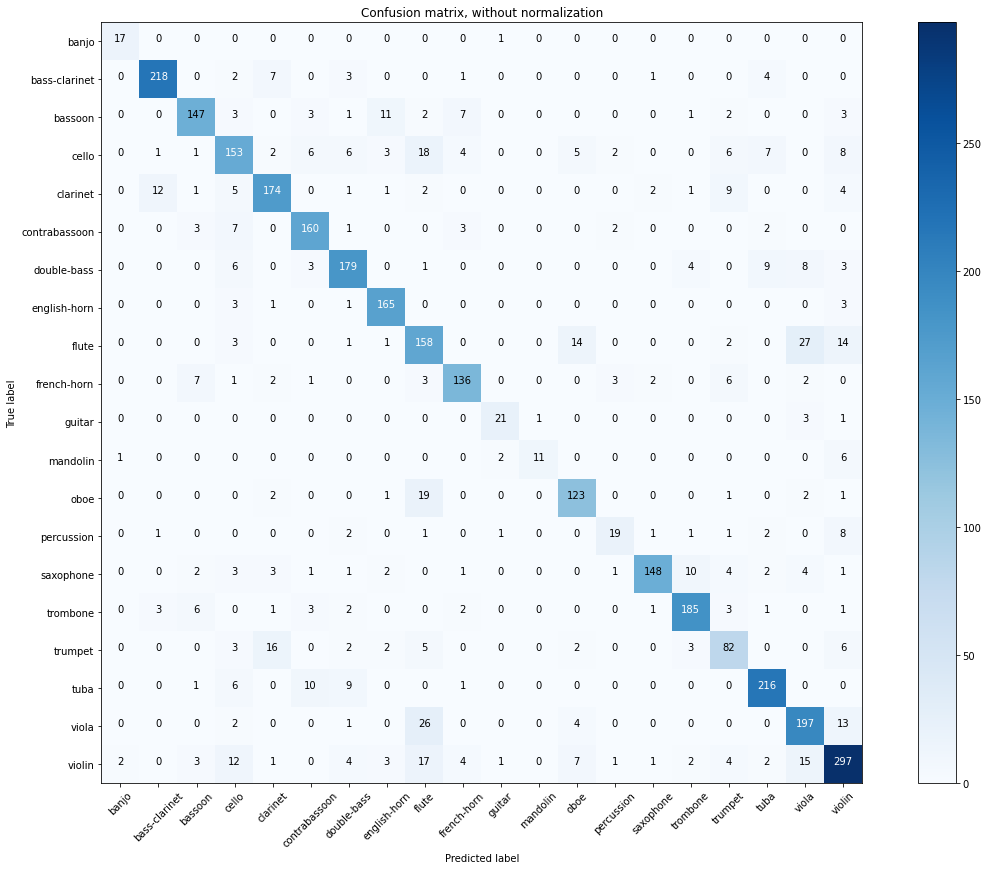

In [ ]:
# Plot non-normalized confusion matrix
plt.figure(figsize=(16,12))
plot_confusion_matrix(cnf_matrix, classes=labelencoder.classes_,
                      title='Confusion matrix, without normalization')

### Playback of Audio Files after Training


In [ ]:
# Test
test_encoded, test_output, test_type = autoencoder(audio_to_test.to(device))
print('Original Shape', audio_to_test.shape)
print('Encoded Shape', test_encoded.shape)
print('Decoded Shape', test_output.shape)
print('Predicted Class', np.argmax(test_type.detach().cpu().numpy()))
print('Correct Class', np.argmax(label_to_test.detach().cpu().numpy()))
print('MSE', mean_squared_error(audio_to_test[0,0,:], test_output[0,0,:audio_to_test.shape[-1]].detach().cpu()))


Original Shape torch.Size([1, 1, 33408])
Encoded Shape torch.Size([1, 512, 66])
Decoded Shape torch.Size([1, 1, 34302])
Predicted Class 1
Correct Class 1
MSE 1.293598e-06


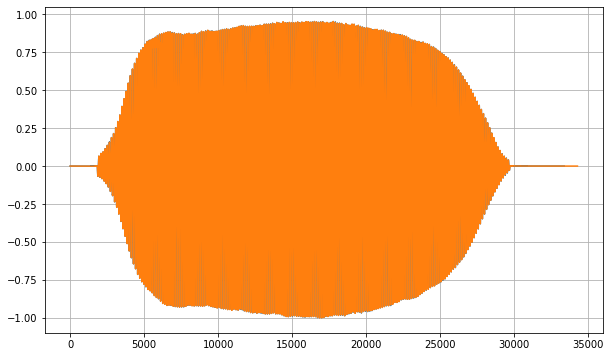

In [ ]:
# Plot Waveform of audio to test
plt.figure(figsize=(10,6))
plt.plot(audio_to_test[0,0,:])
plt.plot(test_output[0,0,:].detach().cpu().numpy())
plt.grid()

In [ ]:
print("Model Output")
display(ipd.Audio(test_output[0,0,:].detach().cpu().numpy(), rate=44100))
print("Model Input")
display(ipd.Audio(audio_to_test[0,0,:], rate=44100))

Model Output


Model Input


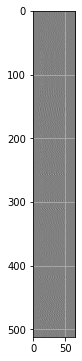

In [ ]:
# Plot of encoded audio to test
plt.figure(figsize=(10,6))
plt.imshow(test_encoded[0,:,:].detach().cpu().numpy(), cmap='gray')
plt.grid()

In [ ]:
# Get a random audio file and label from dataset
dataiter = iter(DataLoader(test_set_torch, batch_size=1, shuffle=True, num_workers=0))
audio_to_test, label_to_test = dataiter.next()

In [ ]:
# Test
test_encoded, test_output, test_type = autoencoder(audio_to_test.to(device))
print('Original Shape', audio_to_test.shape)
print('Encoded Shape', test_encoded.shape)
print('Decoded Shape', test_output.shape)
print('Predicted Class', np.argmax(test_type.detach().cpu().numpy()))
print('Correct Class', np.argmax(label_to_test.detach().cpu().numpy()))
print('MSE', mean_squared_error(audio_to_test[0,0,:], test_output[0,0,:audio_to_test.shape[-1]].detach().cpu()))


Original Shape torch.Size([1, 1, 48384])
Encoded Shape torch.Size([1, 512, 95])
Decoded Shape torch.Size([1, 1, 49150])
Predicted Class 7
Correct Class 7
MSE 2.2516535e-06


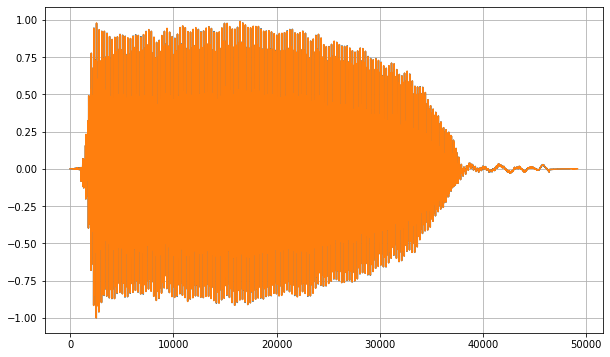

In [ ]:
# Plot Waveform of audio to test
plt.figure(figsize=(10,6))
plt.plot(audio_to_test[0,0,:])
plt.plot(test_output[0,0,:].detach().cpu().numpy())
plt.grid()

In [ ]:
# Calculate Spectrogram of the audio file to test
specgram = torchaudio.transforms.Spectrogram(n_fft=2048)(audio_to_test[0,0,:])


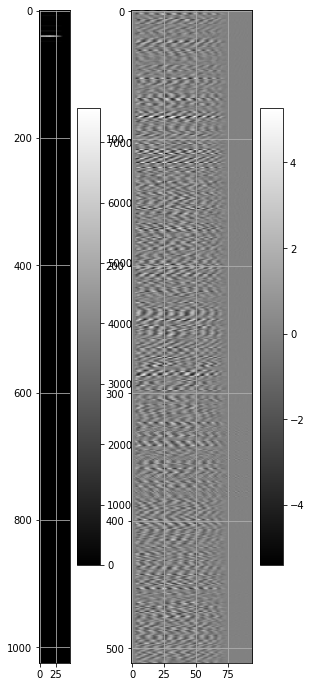

In [ ]:
# Plot Spectrogram of audio to test
plt.figure(figsize=(6,12))
plt.subplot(1,2,1)
plt.imshow(specgram.numpy(), cmap='gray')
plt.colorbar()
plt.grid()
# Plot of encoded audio to test
plt.subplot(1,2,2)
plt.imshow(test_encoded[0,:,:].detach().cpu().numpy(), cmap='gray')
plt.colorbar()
plt.grid()

In [ ]:
!ls checkpoints -l


total 822404
-rw-r--r-- 1 root root 8417681 Jan 11 10:19 AutoencoderInstrumetClassif-601.pkl
-rw-r--r-- 1 root root 8417681 Jan 11 10:22 AutoencoderInstrumetClassif-602.pkl
-rw-r--r-- 1 root root 8417681 Jan 11 10:24 AutoencoderInstrumetClassif-603.pkl
-rw-r--r-- 1 root root 8417681 Jan 11 10:26 AutoencoderInstrumetClassif-604.pkl
-rw-r--r-- 1 root root 8417681 Jan 11 10:28 AutoencoderInstrumetClassif-605.pkl
-rw-r--r-- 1 root root 8417681 Jan 11 10:30 AutoencoderInstrumetClassif-606.pkl
-rw-r--r-- 1 root root 8417681 Jan 11 10:31 AutoencoderInstrumetClassif-607.pkl
-rw-r--r-- 1 root root 8417681 Jan 11 10:33 AutoencoderInstrumetClassif-608.pkl
-rw-r--r-- 1 root root 8417681 Jan 11 10:35 AutoencoderInstrumetClassif-609.pkl
-rw-r--r-- 1 root root 8417681 Jan 11 10:37 AutoencoderInstrumetClassif-610.pkl
-rw-r--r-- 1 root root 8417681 Jan 11 10:38 AutoencoderInstrumetClassif-611.pkl
-rw-r--r-- 1 root root 8417681 Jan 11 10:40 AutoencoderInstrumetClassif-612.pkl
-rw-r--r-- 1 root root 8417

In [ ]:
#from google.colab import files
#files.download('./checkpoints/basicInstrumetClassif-382.pkl') 

# **Creating Zip for runs and checkpoints for tensor board and model parameters**

In [ ]:
!zip -r /content/runs_700.zip /content/runs

In [ ]:
!zip -r /content/best_checkpoints_694_for_600_to_700iter.zip /content/checkpoints/AutoencoderInstrumetClassif-694.pkl

  adding: content/checkpoints/AutoencoderInstrumetClassif-694.pkl (deflated 11%)


In [ ]:
!zip -r /content/last_checkpoints_700.zip /content/checkpoints/AutoencoderInstrumetClassif-700.pkl

  adding: content/checkpoints/AutoencoderInstrumetClassif-700.pkl (deflated 11%)


# **Mounting google drive for uploading of zip files**

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!cp "./best_checkpoints_694_for_600_to_700iter.zip" -r "/content/drive/My Drive/checkpoints"

In [ ]:
!cp "./last_checkpoints_700.zip" -r "/content/drive/My Drive/checkpoints"

In [ ]:
!cp "./runs_700.zip" -r "/content/drive/My Drive/Runs"